In [2]:
# Read necessary modules
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
import os
from os import listdir
from os.path import isfile, join
from itertools import chain
from PIL import Image
import seaborn as sns
import random
from tensorflow.keras.utils import to_categorical
import keras
from keras import layers
from sklearn.metrics import accuracy_score, log_loss, confusion_matrix, ConfusionMatrixDisplay

## Deep Learning Challenge
The deep learning challenge I will take on is '[the Kaggle Natural Images Challenge](https://www.kaggle.com/datasets/prasunroy/natural-images)'.<br> The data set in this challenge was originally created for research on deep learning achitectures. The data set consists of 6.899 images across eight categories.<br>  Naturally, the challenge is to classify each image correct. The categories are:

- Airplane
- Car
- Cat
- Dog
- Flower
- Fruit
- Motorbike
- Person

In [3]:
# Function to create dataframe with file names, file paths and labels (based on label)
def cat_dataframe(mother_path, label):
    # Path for specific image category 
    mother = mother_path #'/kaggle/input/natural-images/natural_images/airplane'
    
    # Put all image names in list 
    onlyfiles = [f for f in listdir(mother) if isfile(join(mother, f))]

    # Put complete file paths for category in list  
    filepath = []
    for i in onlyfiles:
        filepath.append(mother + '/' + i)
        
    # List containing labels for specific category
    cat_list = [label] * len(onlyfiles) 

    # Put filenames, filepaths and labels in dataframe
    df = pd.DataFrame({'filename': onlyfiles, 'filepath': filepath, 'label': cat_list})

    return df 
    

In [4]:
# Put all categories in a separate dataframe with cat_dataframe function
airplane_df = cat_dataframe('/kaggle/input/natural-images/natural_images/airplane', '0')
car_df = cat_dataframe('/kaggle/input/natural-images/natural_images/car', '1')
cat_df = cat_dataframe('/kaggle/input/natural-images/natural_images/cat', '2')
dog_df = cat_dataframe('/kaggle/input/natural-images/natural_images/dog', '3')
flower_df = cat_dataframe('/kaggle/input/natural-images/natural_images/flower', '4')
fruit_df = cat_dataframe('/kaggle/input/natural-images/natural_images/fruit', '5')
motorbike_df = cat_dataframe('/kaggle/input/natural-images/natural_images/motorbike', '6')
person_df = cat_dataframe('/kaggle/input/natural-images/natural_images/person', '7')


# Concatenate all separate dataframes into one dataframe 
df_total = pd.concat([airplane_df, car_df, cat_df, dog_df, flower_df, fruit_df, motorbike_df,person_df])

# Reset the index, so index count goes from 0 until length of df_total 
df_total.reset_index(drop= True, inplace = True)

# Now every filename has an unique identifier
df_total['id'] = df_total.index

In [4]:
df_total

,filename,filepath,label,id
0,airplane_0181.jpg,/kaggle/input/natural-images/natural_images/ai...,0,0
1,airplane_0500.jpg,/kaggle/input/natural-images/natural_images/ai...,0,1
2,airplane_0433.jpg,/kaggle/input/natural-images/natural_images/ai...,0,2
3,airplane_0647.jpg,/kaggle/input/natural-images/natural_images/ai...,0,3
4,airplane_0251.jpg,/kaggle/input/natural-images/natural_images/ai...,0,4
...,...,...,...,...
6894,person_0979.jpg,/kaggle/input/natural-images/natural_images/pe...,7,6894
6895,person_0754.jpg,/kaggle/input/natural-images/natural_images/pe...,7,6895
6896,person_0370.jpg,/kaggle/input/natural-images/natural_images/pe...,7,6896
6897,person_0342.jpg,/kaggle/input/natural-images/natural_images/pe...,7,6897


## Exploratory Data Analysis
#### Count of label categories
The data set is fairly balanced, the category with the most observations is 'Fruit' with 1.000. 'Dog' has the least observations, 702.

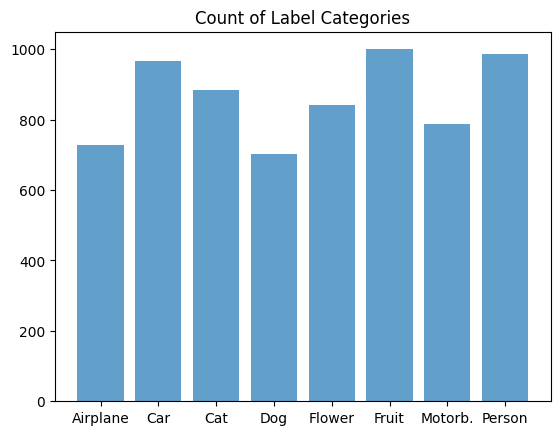

In [5]:
# Bar plot with cont of label categories 
bar_plot =  df_total.groupby('label')['filename'].count()
plt.bar(np.arange(len(bar_plot)),bar_plot, alpha = 0.7)
plt.xticks(np.arange(len(bar_plot)),['Airplane', 'Car', 'Cat', 'Dog', 'Flower', 'Fruit', 'Motorb.', 'Person'])
plt.title('Count of Label Categories')
plt.show()

#### Plotting picture sizes per category

In [6]:
# The main file path (mother) and all of its sub folders (_files)
mother = '/kaggle/input/natural-images/natural_images'
_files = listdir(mother)
_files.sort()

# Initiate lists with pixel sizes and categories
hor_list = []
ver_list = []
cat_list = []

# First loop to get all complete file paths like "/kaggle/input/natural-images/natural_images/airplane/airplane_0029.jpg"
# in onlyfiles
for i in _files:
    
    mother_child = mother + '/' + i

    onlyfiles = [f for f in listdir(mother_child) if isfile(join(mother_child, f))]
    
    # Get the pixel dimensions from every file
    for j in onlyfiles:
        # Read the image 
        im =  Image.open(mother_child + '/' + j)
        
        # Get the image shape
        im_shape = np.shape(im)

        # number of pixels: vertical 
        ver_list.append(im_shape[0])
        
        # number of pixels: horizontal 
        hor_list.append(im_shape[1])
        
        # Get the corresponding category 
        cat_list.append(i)


In [7]:
# Put pixel dimensions along with label in a dataframe
Pix_dimensions = pd.DataFrame({'pix_ver': ver_list, 'pix_hor': hor_list, 'label': cat_list})
Pix_dimensions

,pix_ver,pix_hor,label
0,86,296,airplane
1,99,293,airplane
2,83,295,airplane
3,88,306,airplane
4,107,280,airplane
...,...,...,...
6894,250,250,person
6895,256,256,person
6896,256,256,person
6897,256,256,person


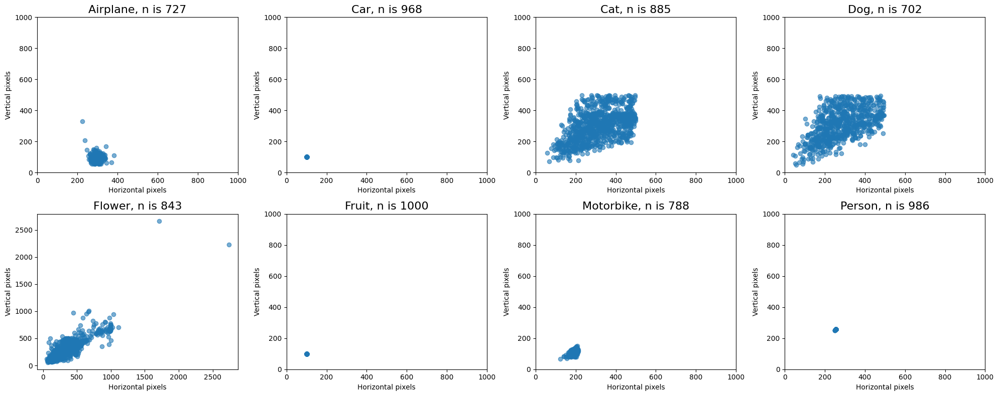

In [8]:
# Scatter plots of the pixel size per category 
fig, ax = plt.subplots(2, 4, figsize=(20, 8))

ax[0,0].scatter(Pix_dimensions[Pix_dimensions.label == 'airplane'].pix_hor, Pix_dimensions[Pix_dimensions.label == 'airplane'].pix_ver, alpha = 0.6)
ax[0,0].set_ylim(0,1000)
ax[0,0].set_xlim(0,1000)
ax[0,0].set_ylabel('Vertical pixels')
ax[0,0].set_xlabel('Horizontal pixels')
ax[0,0].set_title('Airplane, n is {}'.format(len(Pix_dimensions[Pix_dimensions.label == 'airplane'])), size = 16)

ax[0,1].scatter(Pix_dimensions[Pix_dimensions.label == 'car'].pix_hor, Pix_dimensions[Pix_dimensions.label == 'car'].pix_ver)
ax[0,1].set_ylim(0,1000)
ax[0,1].set_xlim(0,1000)
ax[0,1].set_ylabel('Vertical pixels')
ax[0,1].set_xlabel('Horizontal pixels')
ax[0,1].set_title('Car, n is {}'.format(len(Pix_dimensions[Pix_dimensions.label == 'car'])), size = 16)

ax[0,2].scatter(Pix_dimensions[Pix_dimensions.label == 'cat'].pix_hor, Pix_dimensions[Pix_dimensions.label == 'cat'].pix_ver, alpha = 0.6)
ax[0,2].set_ylim(0,1000)
ax[0,2].set_xlim(0,1000)
ax[0,2].set_ylabel('Vertical pixels')
ax[0,2].set_xlabel('Horizontal pixels')
ax[0,2].set_title('Cat, n is {}'.format(len(Pix_dimensions[Pix_dimensions.label == 'cat'])), size = 16)

ax[0,3].scatter(Pix_dimensions[Pix_dimensions.label == 'dog'].pix_hor, Pix_dimensions[Pix_dimensions.label == 'dog'].pix_ver, alpha = 0.6)
ax[0,3].set_ylim(0,1000)
ax[0,3].set_xlim(0,1000)
ax[0,3].set_ylabel('Vertical pixels')
ax[0,3].set_xlabel('Horizontal pixels')
ax[0,3].set_title('Dog, n is {}'.format(len(Pix_dimensions[Pix_dimensions.label == 'dog'])), size = 16)

ax[1,0].scatter(Pix_dimensions[Pix_dimensions.label == 'flower'].pix_hor, Pix_dimensions[Pix_dimensions.label == 'flower'].pix_ver, alpha = 0.6)
ax[1,0].set_ylabel('Vertical pixels')
ax[1,0].set_xlabel('Horizontal pixels')
ax[1,0].set_title('Flower, n is {}'.format(len(Pix_dimensions[Pix_dimensions.label == 'flower'])), size = 16)

ax[1,1].scatter(Pix_dimensions[Pix_dimensions.label == 'fruit'].pix_hor, Pix_dimensions[Pix_dimensions.label == 'fruit'].pix_ver)
ax[1,1].set_ylim(0,1000)
ax[1,1].set_xlim(0,1000)
ax[1,1].set_ylabel('Vertical pixels')
ax[1,1].set_xlabel('Horizontal pixels')
ax[1,1].set_title('Fruit, n is {}'.format(len(Pix_dimensions[Pix_dimensions.label == 'fruit'])), size = 16)

ax[1,2].scatter(Pix_dimensions[Pix_dimensions.label == 'motorbike'].pix_hor, Pix_dimensions[Pix_dimensions.label == 'motorbike'].pix_ver, alpha = 0.6)
ax[1,2].set_ylim(0,1000)
ax[1,2].set_xlim(0,1000)
ax[1,2].set_ylabel('Vertical pixels')
ax[1,2].set_xlabel('Horizontal pixels')
ax[1,2].set_title('Motorbike, n is {}'.format(len(Pix_dimensions[Pix_dimensions.label == 'motorbike'])), size = 16)

ax[1,3].scatter(Pix_dimensions[Pix_dimensions.label == 'person'].pix_hor, Pix_dimensions[Pix_dimensions.label == 'person'].pix_ver)
ax[1,3].set_ylim(0,1000)
ax[1,3].set_xlim(0,1000)
ax[1,3].set_xlabel('Horizontal pixels')
ax[1,3].set_ylabel('Vertical pixels')
ax[1,3].set_title('Person, n is {}'.format(len(Pix_dimensions[Pix_dimensions.label == 'person'])), size = 16)

fig.tight_layout()
plt.show()

- All images within the categories 'Car', 'Fruit' and 'Person' have the same size. 'Motorbike' photos are largely clustered between 100x100 and 200x200. 
- Images in the categories 'Cat' and 'Dog' can range anywhere from 50x50 to 500x500. In the category 'Flower' the range is even bigger: From 50x50 to 1.000x1.000. This category also has two very noticeable outliers. 
- All 'Airplane' photos are smaller than 400x400. Most pictures are aproximately 300x100.    

#### Taking a closer look at the two outliers 

In [9]:
pd.options.display.max_colwidth = 100

# The two outliers in the flower data set
print(Pix_dimensions[(Pix_dimensions.label == 'flower') & (Pix_dimensions.pix_ver > 2000) & (Pix_dimensions.pix_hor > 1500)])

df_total[(df_total.id == 3283) |(df_total.id == 4018)]

      pix_ver  pix_hor   label
3283     2229     2737  flower
4018     2665     1710  flower


,filename,filepath,label,id
3283,flower_0339.jpg,/kaggle/input/natural-images/natural_images/flower/flower_0339.jpg,4,3283
4018,flower_0211.jpg,/kaggle/input/natural-images/natural_images/flower/flower_0211.jpg,4,4018


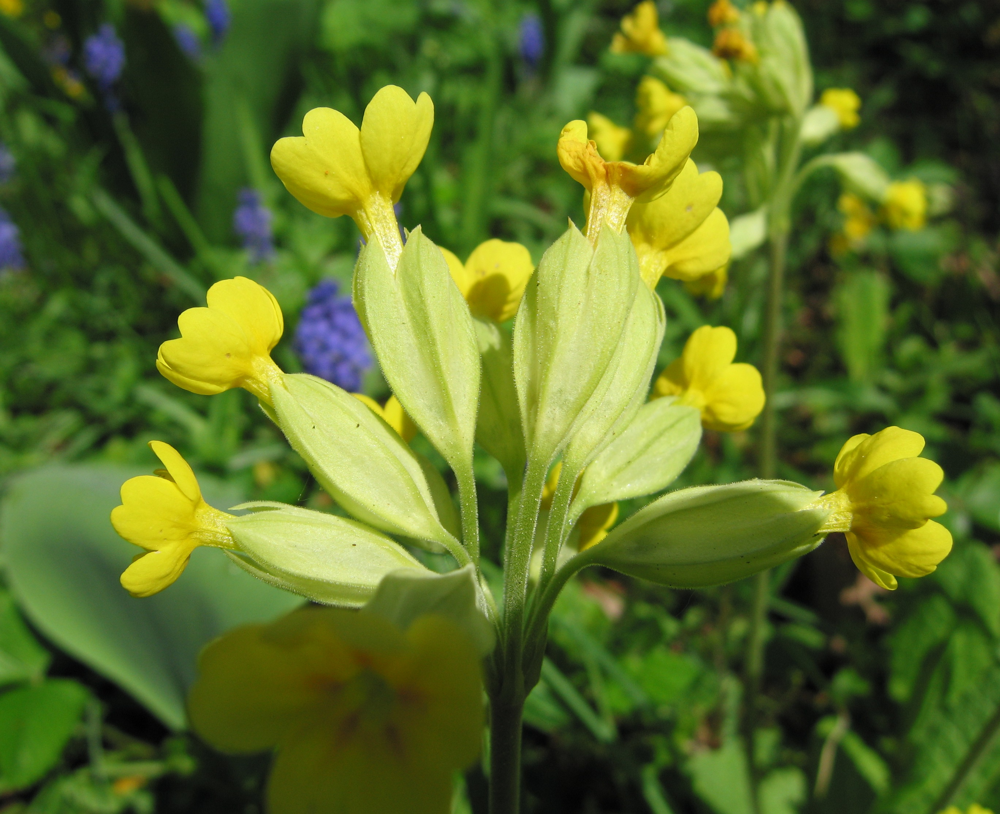

In [10]:
# Outlier 1: flower_0339.jpg
Image.open('/kaggle/input/natural-images/natural_images/flower/flower_0339.jpg')

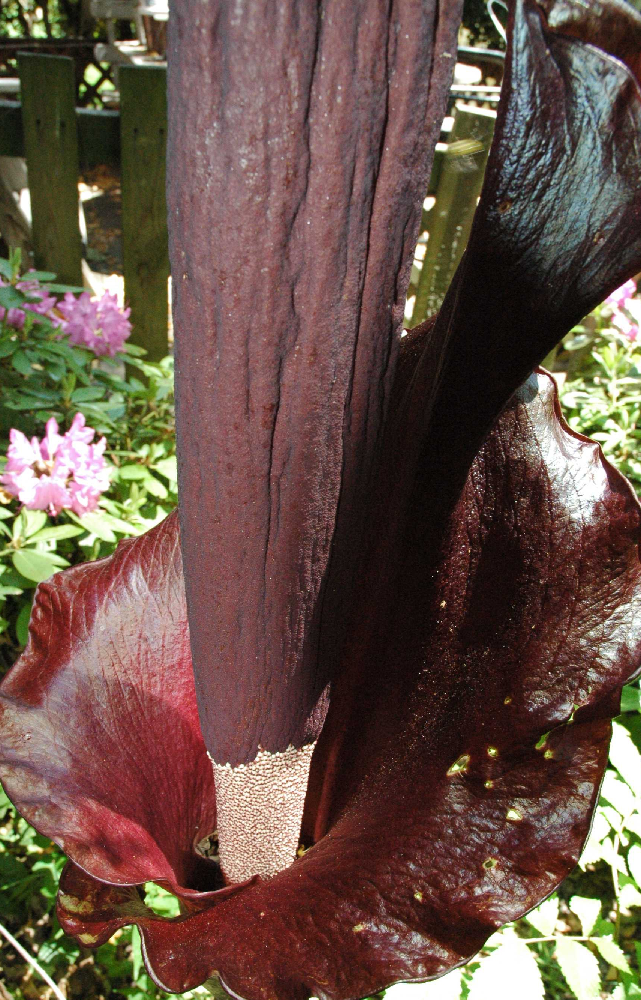

In [11]:
# Outlier 2: flower_0211.jpg
Image.open('/kaggle/input/natural-images/natural_images/flower/flower_0211.jpg')

#### RGB Boxplots
For all categories I take a 1 percent sample of the arrays, which are converted from the pictures. The dimensions of these arrays are their size times 3. The three stands for Red, Green and Blue in the RGB color scheme. Thus, a picture of 50 by 50 has 7.500 elements (50x50x3).
For every picture I separate the elements by color and put them in color separated lists.<br> For this example, 2.500 elements would go into three lists. After doing this for all images I take a sample of 1%. Since there are eight categories I do this eight times. 

In [12]:
# Function to put RGB data in format to plot boxplot
def sample_box(category):

    # The main file path (mother) and all of its sub folders (_files)
    mother = '/kaggle/input/natural-images/natural_images'
    _files = category
    
    R_totaal = []
    G_totaal = []
    B_totaal = []
    cat_list = []
    
    # First loop to get all complete file paths like "/kaggle/input/natural-images/natural_images/airplane/airplane_0029.jpg"
    # in onlyfiles        
    mother_child = mother + '/' + _files

    onlyfiles = [f for f in listdir(mother_child) if isfile(join(mother_child, f))]
    
    # Get the pixel dimensions from every file
    for j in onlyfiles:
        # Read the image 
        im =  Image.open(mother_child + '/' + j)
        # Convert image to array
        im_array = np.array(im)

        # Red 
        R_list = list(chain.from_iterable(im_array[:,:,0]))
        # Green
        G_list = list(chain.from_iterable(im_array[:,:,1]))
        # Blue
        B_list = list(chain.from_iterable(im_array[:,:,2]))
        # Put RGB values into separate lists containing RGB values for all images 
        for a, b, c in zip(R_list, G_list, B_list):
            R_totaal.append(a)
            G_totaal.append(b)
            B_totaal.append(c)
    ## For efficiency reasons, select 1% each of observations in R_totaal, G_totaal and B_totaal
    # sample is reproducable
    random.seed(55)
    
    R_totaal_sample = random.sample(R_totaal, round(0.01*len(R_totaal)))

    G_totaal_sample = random.sample(G_totaal, round(0.01*len(G_totaal)))

    B_totaal_sample = random.sample(B_totaal, round(0.01*len(B_totaal)))
  
    cat_list = [category] * len(R_totaal_sample)
    
    # Put the selected observations plus the category in a list  
    Box_red_df = pd.DataFrame({'Value': R_totaal_sample,  'Label': 'Red'})

    Box_green_df = pd.DataFrame({'Value': G_totaal_sample,  'Label': 'Green'})

    Box_blue_df = pd.DataFrame({'Value': B_totaal_sample,  'Label': 'Blue'})

    Box_df = pd.concat([Box_red_df, Box_green_df, Box_blue_df])

    return Box_df

In [13]:
# Apply sample_box for every category 
box_airplane = sample_box('airplane')
box_car = sample_box('car')
box_cat = sample_box('cat')
box_dog = sample_box('dog')
box_flower = sample_box('flower')
box_fruit = sample_box('fruit')
box_motorbike = sample_box('motorbike')
box_person = sample_box('person')

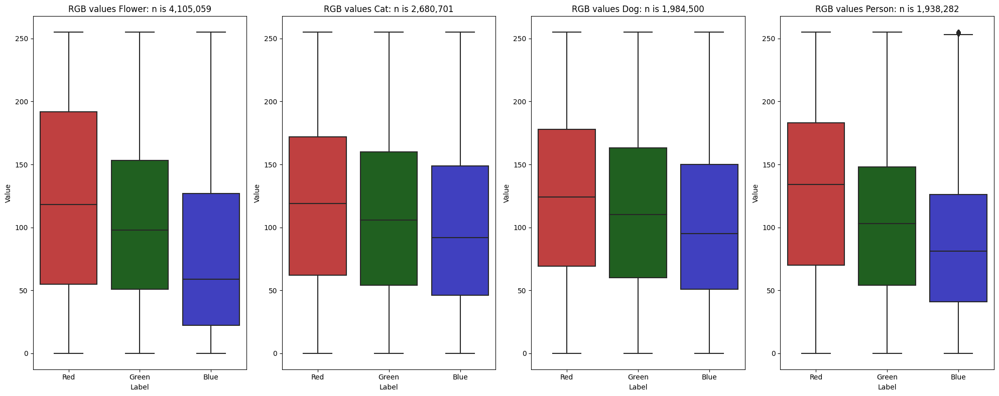

In [14]:
# Plot boxplots of the picture categories (I)
fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(20, 8))
my_pal = {"Red": "r", "Blue": "b", "Green": "g"}

sns.boxplot(data = box_flower, x = 'Label', y = 'Value', palette = my_pal, saturation = 0.5, ax= ax1)
sns.boxplot(data = box_cat, x = 'Label', y = 'Value', palette = my_pal, saturation = 0.5, ax= ax2)
sns.boxplot(data = box_dog, x = 'Label', y = 'Value', palette = my_pal, saturation = 0.5, ax= ax3)
sns.boxplot(data = box_person, x = 'Label', y = 'Value', palette = my_pal, saturation = 0.5, ax= ax4)

ax1.set_title('RGB values Flower: n is {:,}'.format(len(box_flower)))
ax2.set_title('RGB values Cat: n is {:,}'.format(len(box_cat)))
ax3.set_title('RGB values Dog: n is {:,}'.format(len(box_dog)))
ax4.set_title('RGB values Person: n is {:,}'.format(len(box_person)))

fig.tight_layout()
plt.show()
#plt.savefig('/kaggle/working/boxplot1.jpg')

The four boxplots of images depicting living creatures (cats, dogs, flowers and persons) show the same pattern, the strength of the shades of R,G and B is in descending order. <br> 
- 'Flower' shows the biggest contrasts between the three colors, with the strongest shades of red. Because flowers tend to be bright, this is not surprising.
- The 'Cat' and 'Dog' boxplots show a similar pattern, with the 25%-75% range for R,G and B at similar places. The reason is likely the identical build of cats and dogs (Four legs and a fur).
- Interestingly, for the category 'Person' the RGB pattern bares more of a resemblance to the 'Flower' boxplot than the boxplots of 'Cat' and 'Dog': Strong shades of Red and comparatively weak shades of Green and Blue. My assumption is that this occurs because the 'Person' images are facial shots of tanned and blushing people.       

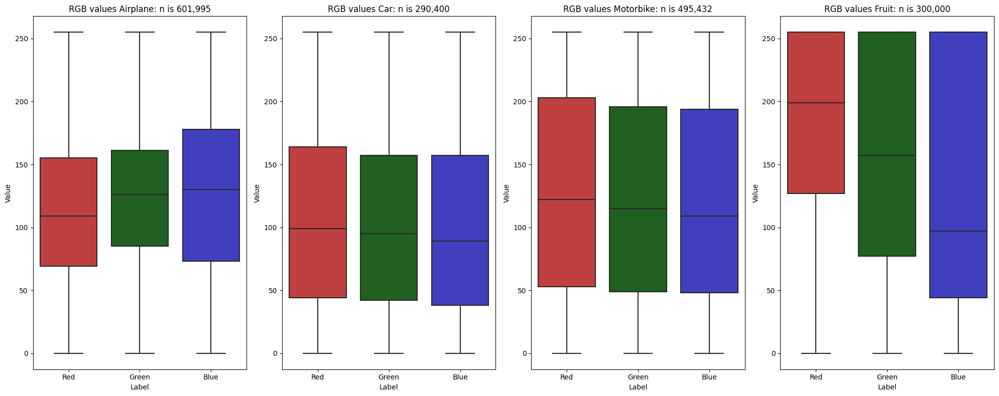

In [15]:
# Plot boxplots of the picture categories (II)
fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(20, 8))
my_pal = {"Red": "r", "Blue": "b", "Green": "g"}

sns.boxplot(data = box_airplane, x = 'Label', y = 'Value', palette = my_pal, saturation = 0.5, ax= ax1)
sns.boxplot(data = box_car, x = 'Label', y = 'Value', palette = my_pal, saturation = 0.5, ax= ax2)
sns.boxplot(data = box_motorbike, x = 'Label', y = 'Value', palette = my_pal, saturation = 0.5, ax= ax3)
sns.boxplot(data = box_fruit, x = 'Label', y = 'Value', palette = my_pal, saturation = 0.5, ax= ax4)

ax1.set_title('RGB values Airplane: n is {:,}'.format(len(box_airplane)))
ax2.set_title('RGB values Car: n is {:,}'. format(len(box_car)))
ax3.set_title('RGB values Motorbike: n is {:,}'. format(len(box_motorbike)))
ax4.set_title('RGB values Fruit: n is {:,}'.format(len(box_fruit)))

fig.tight_layout()
plt.show()
#plt.savefig('/kaggle/working/boxplot2.jpg')

Compared to the boxplots of the living organisms, the boxplots of the non living things show an equality in the RGB distributions. <br>
- The exception is the 'Airplane' boxplot, the likely reason is that in phots of flying planes skies are in the background and take up a sizeable portion of the background. <br>
- In the boxplots of 'Car' and 'Motorbike', the boxes of R, G and B are at equal points and have equal ranges. A possible reason is that cars and motors do not have a natural color (i.e. can be manufactured in any color). <br>
- The pictures of the category 'Fruit' (at least according to the sample) have strong shades of all three colors. This probably means the data set contains a large variety of fruits.    

#### Resizing the images

In [16]:
# Select 5 random images to test resizing 
sample_resize = df_total.sample(n = 5, random_state = 7)
sample_resize

,filename,filepath,label,id
6895,person_0754.jpg,/kaggle/input/natural-images/natural_images/person/person_0754.jpg,7,6895
962,car_0517.jpg,/kaggle/input/natural-images/natural_images/car/car_0517.jpg,1,962
4896,fruit_0628.jpg,/kaggle/input/natural-images/natural_images/fruit/fruit_0628.jpg,5,4896
1910,cat_0752.jpg,/kaggle/input/natural-images/natural_images/cat/cat_0752.jpg,2,1910
2222,cat_0455.jpg,/kaggle/input/natural-images/natural_images/cat/cat_0455.jpg,2,2222


In [17]:
# Get file sizes of observations in sample
sample_resize_I = pd.merge(sample_resize, Pix_dimensions, left_index= True, right_index= True).loc[:,['filename','filepath','pix_ver', 'pix_hor']]
sample_resize_I

,filename,filepath,pix_ver,pix_hor
6895,person_0754.jpg,/kaggle/input/natural-images/natural_images/person/person_0754.jpg,256,256
962,car_0517.jpg,/kaggle/input/natural-images/natural_images/car/car_0517.jpg,100,100
4896,fruit_0628.jpg,/kaggle/input/natural-images/natural_images/fruit/fruit_0628.jpg,100,100
1910,cat_0752.jpg,/kaggle/input/natural-images/natural_images/cat/cat_0752.jpg,367,439
2222,cat_0455.jpg,/kaggle/input/natural-images/natural_images/cat/cat_0455.jpg,322,491


#### Test of resizing the images 

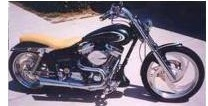

In [18]:
size = (100, 100)
userImage = Image.open("/kaggle/input/natural-images/natural_images/motorbike/motorbike_0139.jpg")
userImage

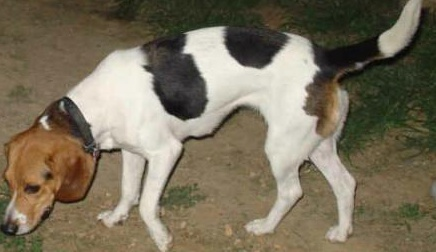

In [19]:
userImage = Image.open("/kaggle/input/natural-images/natural_images/dog/dog_0465.jpg")
userImage

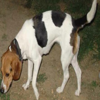

In [20]:
userImage.resize(size)

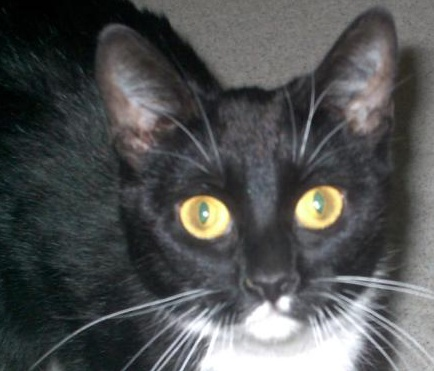

In [21]:
userImage = Image.open("/kaggle/input/natural-images/natural_images/cat/cat_0095.jpg")
userImage

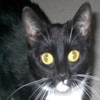

In [22]:
userImage.resize(size)

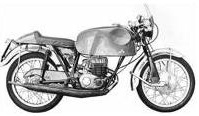

In [23]:
userImage = Image.open("/kaggle/input/natural-images/natural_images/motorbike/motorbike_0567.jpg")
userImage

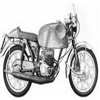

In [24]:
userImage.resize(size)

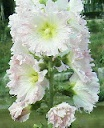

In [25]:
userImage = Image.open("/kaggle/input/natural-images/natural_images/flower/flower_0243.jpg")
userImage

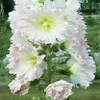

In [26]:
userImage.resize(size)

In [18]:
# Size of the sample 
N = round(0.1*len(df_total))

# Data set with test observations
test_df = df_total.groupby('label', group_keys=False)[['filename','filepath', 'label', 'id']].apply(lambda x: x.sample(int(np.rint(N*len(x)/len(df_total))),random_state = 38)).sample(frac=1, random_state = 39)
test_df

,filename,filepath,label,id
4401,fruit_0860.jpg,/kaggle/input/natural-images/natural_images/fr...,5,4401
3084,dog_0456.jpg,/kaggle/input/natural-images/natural_images/do...,3,3084
2725,dog_0416.jpg,/kaggle/input/natural-images/natural_images/do...,3,2725
2083,cat_0427.jpg,/kaggle/input/natural-images/natural_images/ca...,2,2083
1074,car_0023.jpg,/kaggle/input/natural-images/natural_images/ca...,1,1074
...,...,...,...,...
5685,motorbike_0528.jpg,/kaggle/input/natural-images/natural_images/mo...,6,5685
401,airplane_0574.jpg,/kaggle/input/natural-images/natural_images/ai...,0,401
11,airplane_0487.jpg,/kaggle/input/natural-images/natural_images/ai...,0,11
1462,car_0242.jpg,/kaggle/input/natural-images/natural_images/ca...,1,1462


In [19]:
# Apply outer join to select the observations from df_total_new not in test_df
outer =  df_total.merge(test_df, how = 'outer',right_on = 'id', left_on = 'id', indicator= True)

# Select necessary columns for the training set
train_df = outer[(outer._merge=='left_only')].drop('_merge', axis=1).loc[:,['filename_x', 'filepath_x', 'label_x', 'id']]
train_df.rename(columns = {'filename_x': 'filename', 'filepath_x': 'filepath', 'label_x': 'label'}, inplace= True)

# Shuffle the observations in train_df
train_df = train_df.sample(frac=1)
train_df

,filename,filepath,label,id
394,airplane_0361.jpg,/kaggle/input/natural-images/natural_images/ai...,0,394
3642,flower_0524.jpg,/kaggle/input/natural-images/natural_images/fl...,4,3642
247,airplane_0095.jpg,/kaggle/input/natural-images/natural_images/ai...,0,247
2706,dog_0218.jpg,/kaggle/input/natural-images/natural_images/do...,3,2706
3770,flower_0072.jpg,/kaggle/input/natural-images/natural_images/fl...,4,3770
...,...,...,...,...
5030,fruit_0832.jpg,/kaggle/input/natural-images/natural_images/fr...,5,5030
884,car_0041.jpg,/kaggle/input/natural-images/natural_images/ca...,1,884
6663,person_0652.jpg,/kaggle/input/natural-images/natural_images/pe...,7,6663
6887,person_0872.jpg,/kaggle/input/natural-images/natural_images/pe...,7,6887


In [20]:
# Function to export the resized images to working directory
def zip_export(df,token_label):

    newpath = '/kaggle/working/{}'.format(token_label) 
    os.makedirs(newpath)
    
    size = (100, 100)

    for i,j in zip(df.filepath,df.filename):

        userImage = Image.open(i)

        userImage_new = userImage.resize(size)

        userImage_new.save("/kaggle/working/{}/".format(token_label) + j[:-4] + "_new" + ".jpg")   

In [21]:
# Apply function to train and test data
zip_export(train_df,'train')
zip_export(test_df,'test')

#### Functions for CNN fitting and evaluating

In [22]:
# Function to convert images into arrays (train set)
def to_array(train_df = train_df):

    # String of working directory
    train_dir = '/kaggle/working/train'
    
    imarray_totaal = []
    # Loop to import training images n train_df (by file names) from working directory
    for j in train_df.filename:
    
        im = Image.open(train_dir + '/' + j[:-4] + '_new.jpg')
        # Turn '.tif' file into array
        imarray = np.array(im)
        
        imarray_totaal.append((imarray/127.5)-1)
    
    # Turn list into array
    imarray_totaal= np.array(imarray_totaal)
    
    # One hot encoding for the label: Turning one label (0/1) into two labels (Label_0 and Label_1) 
    num_classes = 8
    labels = to_categorical(train_df.label, num_classes=num_classes)
    
    # Giving imarray_totaal (x_train) and labels (y_train) familiar names 
    x_train = imarray_totaal
    y_train = labels

    return x_train, y_train

In [23]:
# Apply function to_array
train_set = to_array()
x_train = train_set[0]
y_train = train_set[1]

In [24]:
# Function to show the metrics of the final epoch of a CNN
def write_away(name, model_results):

    name = pd.DataFrame.from_dict(model_results)
    nr_columns = len(name)-1

    final_epoch = pd.DataFrame(name.iloc[-1,:])

    final_epoch.rename(columns = {nr_columns: 'Scores'}, inplace= True)
    
    return name, final_epoch

In [25]:
# Function to plot metrics of model fitting
def pd_plot(metric_df, title):

    fig, ax = plt.subplots(2, 1, figsize=(8,6))
    ax[0].plot(metric_df.accuracy, linestyle= 'dashed')
    ax[0].plot(metric_df.val_accuracy, linestyle= 'dotted')
    ax[0].legend(["Accuracy", "Val. Accuracy"], loc="lower right")
    ax[0].set_ylabel('Accuracy')
    ax[0].set_ylim(0,1)
        
    ax[1].plot(metric_df.loss, linestyle= 'dashed')
    ax[1].plot(metric_df.val_loss, linestyle= 'dotted')
    ax[1].legend(["Loss", "Val. Loss"], loc="lower right")
    ax[1].set_ylabel('Loss')
    ax[1].set_xlabel('# Epoch', fontsize = 12)

    ax[0].set_title(title, fontsize = 16)
    
    fig.tight_layout()
    plt.show()

In [26]:
# Function to compute the accuracy and the categorical cross entropy of the test data set
def metrics(y_pred):
    # actual labels
    true = []
    for i in range(len(y_test)):
        true.append( np.where(y_test[i] == max(y_test[i]))[0][0])
    
    # predicted labels
    predictions = []
    for i in range(len(y_pred)):
        predictions.append(np.where(y_pred[i] == max(y_pred[i]))[0][0])

    accuracy = round(accuracy_score(true,predictions),4)

    cat_cross = round(log_loss(y_test, y_pred),4)

    return accuracy, cat_cross


In [27]:
# Function to convert images into arrays (test set)
def to_array_test(test_df = test_df):

    # String of working directory
    test_dir = '/kaggle/working/test'
    
    imarray_totaal = []
    # Loop to import training images n train_df (by file names) from working directory
    for j in test_df.filename:
    
        im = Image.open(test_dir + '/' + j[:-4] + '_new.jpg')
        # Turn '.tif' file into array
        imarray = np.array(im)
        
        imarray_totaal.append((imarray/127.5)-1)
    
    # Turn list into array
    imarray_totaal= np.array(imarray_totaal)
    
    # One hot encoding for the label: Turning one label (0/1) into two labels (Label_0 and Label_1) 
    num_classes = 8
    labels = to_categorical(test_df.label, num_classes=num_classes)
    
    # Giving imarray_totaal (x_train) and labels (y_train) familiar names 
    x_test = imarray_totaal
    y_test = labels

    return x_test, y_test

In [28]:
# Function to plot a confusion matrix of the results  
def plot_confusion_matrix(y_pred):
    # actual labels
    true = []
    for i in range(len(y_test)):
        true.append(np.where(y_test[i] == max(y_test[i]))[0][0])
        
    # predicted labels
    predictions = []
    for i in range(len(y_pred)):
        predictions.append(np.where(y_pred[i] == max(y_pred[i]))[0][0])

    cm = confusion_matrix(true,predictions)

    disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                                  display_labels=['Airplane', 'Car', 'Cat', 'Dog', 'Flower', 'Fruit', 'Motorb.', 'Person'])
    
    disp.plot()
    plt.show()


## Model fitting and evaluation

In [29]:
# Apply function to_array_test
test_set = to_array_test()
x_test = test_set[0]
y_test = test_set[1]

## Model 1
- Two 2 dimensional convolution layers, one with 32 filters and one with 64 filters.
- Batch normalization after every convolution layer.
- 2 dimensional max pooling layers after every instance of batch normalization.
- 20% dropout layer after the final max pooling layer

In [30]:
num_classes = 8
input_shape = (100, 100, 3)

callback = keras.callbacks.EarlyStopping(monitor='loss', patience=3)

model1 = keras.Sequential(
    [keras.Input(shape = input_shape),
     layers.Conv2D(filters = 32, kernel_size=(3,3),activation = 'relu'),
     layers.BatchNormalization(),
     layers.MaxPooling2D(pool_size=(2, 2)),
     layers.Conv2D(64, kernel_size=(3, 3), activation="relu"),
     layers.BatchNormalization(),
     layers.MaxPooling2D(pool_size=(2, 2)),
     layers.Dropout(0.2),
     layers.Flatten(),     
     layers.Dense(num_classes, activation="softmax")
    ]
    )
model1.summary()

I0000 00:00:1765105964.536188      68 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 13942 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5
I0000 00:00:1765105964.536804      68 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 13942 MB memory:  -> device: 1, name: Tesla T4, pci bus id: 0000:00:05.0, compute capability: 7.5


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 98, 98, 32)     │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 98, 98, 32)     │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 49, 49, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 47, 47, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 47, 47, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 23, 23, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 23, 23, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 33856)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 8)              │       270,856 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 290,632 (1.11 MB)

 Trainable params: 290,440 (1.11 MB)

 Non-trainable params: 192 (768.00 B)

In [31]:
# training model 1
epochs = 20
batch_size = 400
model1.compile(loss="categorical_crossentropy", optimizer="adam", metrics=["accuracy"])

In [32]:
history1 = model1.fit(x_train, y_train, batch_size=batch_size, epochs=epochs, validation_split=0.1, callbacks=[callback])

Epoch 1/20


I0000 00:00:1765105982.784648     109 service.cc:148] XLA service 0x7ebbdc00da50 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1765105982.785325     109 service.cc:156]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
I0000 00:00:1765105982.785339     109 service.cc:156]   StreamExecutor device (1): Tesla T4, Compute Capability 7.5
I0000 00:00:1765105983.085508     109 cuda_dnn.cc:529] Loaded cuDNN version 90300


 2/14 ━━━━━━━━━━━━━━━━━━━━ 1s 105ms/step - accuracy: 0.1987 - loss: 4.0380

I0000 00:00:1765105990.158670     109 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


14/14 ━━━━━━━━━━━━━━━━━━━━ 20s 796ms/step - accuracy: 0.5737 - loss: 2.4945 - val_accuracy: 0.7327 - val_loss: 1.0622
Epoch 2/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 104ms/step - accuracy: 0.8843 - loss: 0.5275 - val_accuracy: 0.4928 - val_loss: 1.4369
Epoch 3/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 104ms/step - accuracy: 0.9394 - loss: 0.2201 - val_accuracy: 0.5024 - val_loss: 1.6717
Epoch 4/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 103ms/step - accuracy: 0.9627 - loss: 0.1126 - val_accuracy: 0.4026 - val_loss: 2.6167
Epoch 5/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 103ms/step - accuracy: 0.9818 - loss: 0.0522 - val_accuracy: 0.3784 - val_loss: 3.4493
Epoch 6/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 104ms/step - accuracy: 0.9891 - loss: 0.0312 - val_accuracy: 0.3366 - val_loss: 4.2962
Epoch 7/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 104ms/step - accuracy: 0.9914 - loss: 0.0207 - val_accuracy: 0.3092 - val_loss: 4.9211
Epoch 8/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 104ms/step - accuracy: 0.9959 - loss: 0.0123 - val_accuracy: 0.3076 - val

In [33]:
Baseline_metrics = write_away('CNN_baseline',history1.history)[0]
Baseline_final_epoch = write_away('CNN_baseline',history1.history)[1]

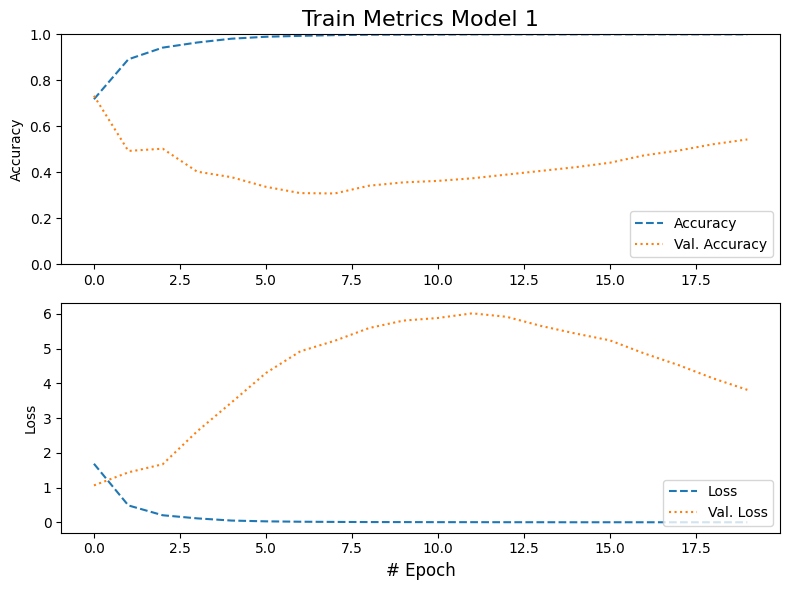

In [34]:
pd_plot(Baseline_metrics, 'Train Metrics Model 1')

In [35]:
Baseline_final_epoch

,Scores
accuracy,0.999821
loss,0.001249
val_accuracy,0.542673
val_loss,3.812391


In [36]:
predict_model1 =  model1.predict(x_test)
accuracy = metrics(predict_model1)[0]
print("The accuracy of Model 1 is {}".format(accuracy))
cat_ce = metrics(predict_model1)[1]
print("The categorical cross entropy of Model 1 is {}".format(cat_ce))

22/22 ━━━━━━━━━━━━━━━━━━━━ 1s 27ms/step
The accuracy of Model 1 is 0.5427
The categorical cross entropy of Model 1 is 3.9184


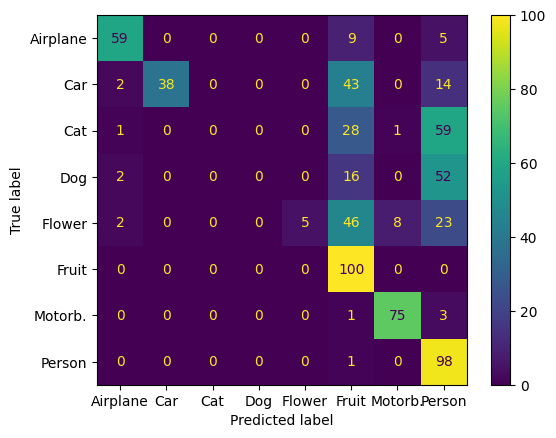

In [37]:
plot_confusion_matrix(predict_model1)

#### Model 1 evaluation
- Difference between training and validation metrics (see `Baseline_final_epoch`) indicates overfitting.
- The test scores (accuracy and categorical cross entropy) confirm the overfitting hypothesis.
- The confusion matrix shows some categories are predicted well ('Airplane', 'Fruit', 'Motorbike', 'Person'), while the predictions of categories 'Car' and especially 'Cat', 'Dog' and 'Flower' show there is room for improvement.  

## Model 2
The CNN has the same specifications as Model 1, with the exception of the learning rate. For Model 2 I set this at 0.00005. The learning rate was 0.001 for Model 1.

In [38]:
model2 = keras.Sequential(
    [keras.Input(shape = input_shape),
     layers.Conv2D(filters = 32, kernel_size=(3,3),activation = 'relu'),
     layers.BatchNormalization(),
     layers.MaxPooling2D(pool_size=(2, 2)),
     layers.Conv2D(64, kernel_size=(3, 3), activation="relu"),
     layers.BatchNormalization(),
     layers.MaxPooling2D(pool_size=(2, 2)),
     layers.Dropout(0.2),
     layers.Flatten(),     
     layers.Dense(num_classes, activation="softmax"),
    ]
    )
model2.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_2 (Conv2D)               │ (None, 98, 98, 32)     │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 98, 98, 32)     │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 49, 49, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 47, 47, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 47, 47, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 23, 23, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 23, 23, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 33856)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 8)              │       270,856 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 290,632 (1.11 MB)

 Trainable params: 290,440 (1.11 MB)

 Non-trainable params: 192 (768.00 B)

In [39]:
# training model 2
epochs = 20
batch_size = 400
model2.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(learning_rate=0.00005), metrics=["accuracy"])

In [40]:
history2 = model2.fit(x_train, y_train, batch_size=batch_size, epochs=epochs, validation_split=0.1, callbacks=[callback])

Epoch 1/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 8s 333ms/step - accuracy: 0.3501 - loss: 2.2470 - val_accuracy: 0.4831 - val_loss: 1.8279
Epoch 2/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step - accuracy: 0.7203 - loss: 0.8349 - val_accuracy: 0.6377 - val_loss: 1.7002
Epoch 3/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 105ms/step - accuracy: 0.8050 - loss: 0.5742 - val_accuracy: 0.6312 - val_loss: 1.6418
Epoch 4/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step - accuracy: 0.8402 - loss: 0.4599 - val_accuracy: 0.5926 - val_loss: 1.6066
Epoch 5/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step - accuracy: 0.8616 - loss: 0.3956 - val_accuracy: 0.5507 - val_loss: 1.5963
Epoch 6/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step - accuracy: 0.8769 - loss: 0.3400 - val_accuracy: 0.5395 - val_loss: 1.5785
Epoch 7/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step - accuracy: 0.9023 - loss: 0.2863 - val_accuracy: 0.5201 - val_loss: 1.5823
Epoch 8/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 106ms/step - accuracy: 0.9089 - loss: 0.2586 - val_accuracy: 0.

In [41]:
metrics_update_I = write_away('CNN',history2.history)[0]
final_epoch_update_I = write_away('CNN',history2.history)[1]

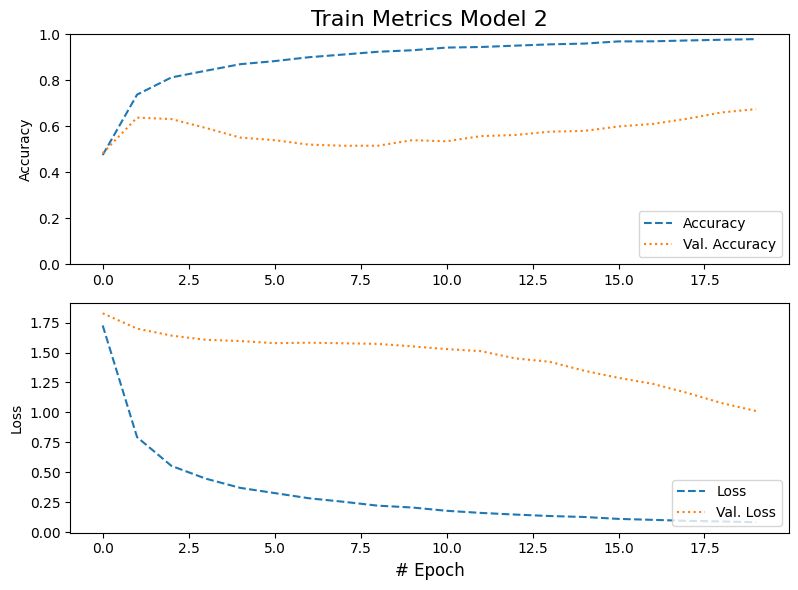

In [42]:
pd_plot(metrics_update_I, 'Train Metrics Model 2')

In [43]:
final_epoch_update_I

,Scores
accuracy,0.979237
loss,0.081313
val_accuracy,0.674718
val_loss,1.011315


In [44]:
predict_model2 =  model2.predict(x_test)
accuracy = metrics(predict_model2)[0]
print("The accuracy of Model 2 is {}".format(accuracy))
cat_ce = metrics(predict_model2)[1]
print("The categorical cross entropy of Model 2 is {}".format(cat_ce))

22/22 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step
The accuracy of Model 2 is 0.6657
The categorical cross entropy of Model 2 is 1.0391


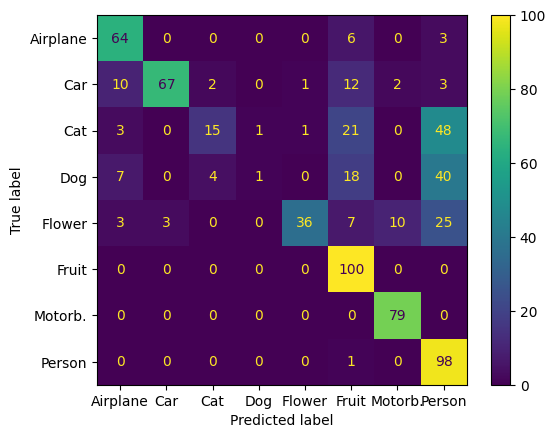

In [45]:
plot_confusion_matrix(predict_model2)

#### Model 2 evaluation
- Again a noticeable difference between the training and validation metrics. However the Model 2 validation scores are better than the Model 1 validation scores.
- The test scores of Model 2 also show a huge improvement compared to Model 1. However, the test scores are still far off from the training scores.
- In the confusion matrix the improvement is most noticeable in the categories 'Car' and 'Flower'. 'Cat' and 'Dog' lag in how accurately they are classified.

## Model 3
For this model I implement a dropout layer of 30% (instead of 20%).

In [46]:
model3 = keras.Sequential(
    [keras.Input(shape = input_shape),
     layers.Conv2D(filters = 32, kernel_size=(3,3),activation = 'relu'),
     layers.BatchNormalization(),
     layers.MaxPooling2D(pool_size=(2, 2)),
     layers.Conv2D(64, kernel_size=(3, 3), activation="relu"),
     layers.BatchNormalization(),
     layers.MaxPooling2D(pool_size=(2, 2)),
     layers.Dropout(0.3),
     layers.Flatten(),     
     layers.Dense(num_classes, activation="softmax"),
    ]
    )
model3.summary()

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_4 (Conv2D)               │ (None, 98, 98, 32)     │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 98, 98, 32)     │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 49, 49, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 47, 47, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 47, 47, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_5 (MaxPooling2D)  │ (None, 23, 23, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 23, 23, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_2 (Flatten)             │ (None, 33856)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 8)              │       270,856 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 290,632 (1.11 MB)

 Trainable params: 290,440 (1.11 MB)

 Non-trainable params: 192 (768.00 B)

In [47]:
# training model 3
epochs = 20
batch_size = 400
model3.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(learning_rate=0.00005), metrics=["accuracy"])

In [48]:
history3 = model3.fit(x_train, y_train, batch_size=batch_size, epochs=epochs, validation_split=0.1, callbacks=[callback])

Epoch 1/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 8s 334ms/step - accuracy: 0.3357 - loss: 2.3829 - val_accuracy: 0.4928 - val_loss: 1.8375
Epoch 2/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 110ms/step - accuracy: 0.6952 - loss: 0.9453 - val_accuracy: 0.6216 - val_loss: 1.7090
Epoch 3/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 0.7937 - loss: 0.6109 - val_accuracy: 0.5443 - val_loss: 1.6630
Epoch 4/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 0.8335 - loss: 0.4639 - val_accuracy: 0.4783 - val_loss: 1.6506
Epoch 5/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 109ms/step - accuracy: 0.8584 - loss: 0.3982 - val_accuracy: 0.4412 - val_loss: 1.6637
Epoch 6/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 110ms/step - accuracy: 0.8761 - loss: 0.3593 - val_accuracy: 0.4155 - val_loss: 1.6882
Epoch 7/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 111ms/step - accuracy: 0.8977 - loss: 0.3052 - val_accuracy: 0.4042 - val_loss: 1.7297
Epoch 8/20
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 111ms/step - accuracy: 0.8899 - loss: 0.2810 - val_accuracy: 0.

In [49]:
metrics_update_II = write_away('CNN',history3.history)[0]
final_epoch_update_II = write_away('CNN',history3.history)[1]

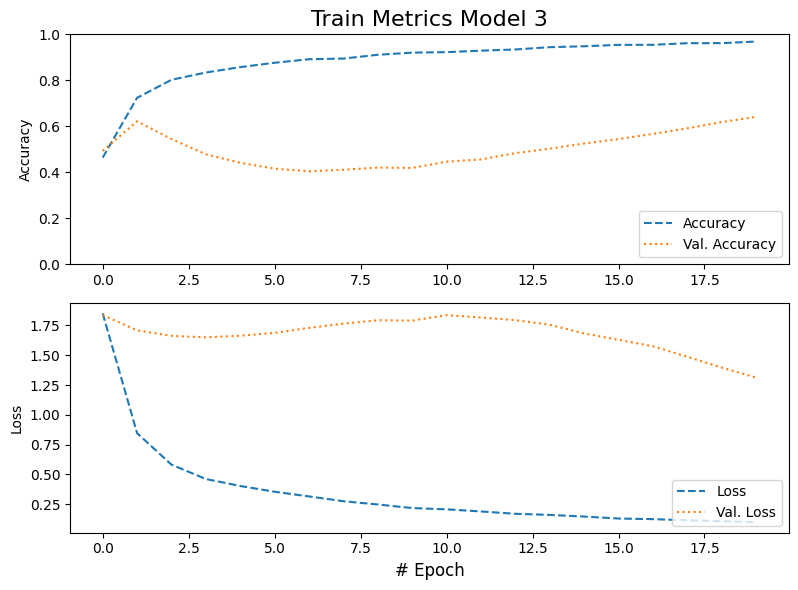

In [50]:
pd_plot(metrics_update_II, 'Train Metrics Model 3')

In [51]:
final_epoch_update_II

,Scores
accuracy,0.968677
loss,0.097481
val_accuracy,0.640902
val_loss,1.313196


In [52]:
predict_model3 =  model3.predict(x_test)
accuracy = metrics(predict_model3)[0]
print("The accuracy of Model 3 is {}".format(accuracy))
cat_ce = metrics(predict_model3)[1]
print("The categorical cross entropy of Model 3 is {}".format(cat_ce))

22/22 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step
The accuracy of Model 3 is 0.6281
The categorical cross entropy of Model 3 is 1.3393


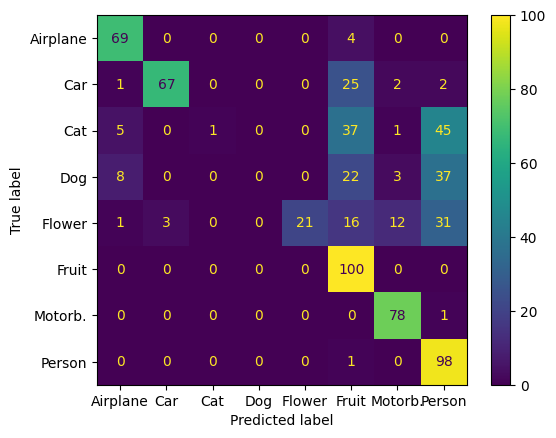

In [53]:
plot_confusion_matrix(predict_model3)

#### Model 3 evaluation
The results are somewhat similar to Model 2:
- The validation accuracy and loss of Model 3 are slightly worse compared to Model 2.
- Like the validation results, the Model 3 test results also lag a little behind Model 2.  
- Four categories are predicted well ('Airplane', 'Fruit', 'Motorbike', 'Person'), one category ('Car') reasonably well and for three categories ('Cat', 'Dog' and 'Flower') there is considerable room for improvement.   

## Model 4
Model 4 has the same specifications as Model 3 but runs for a maximum of 40 epochs, instead of 20.

In [54]:
model4 = keras.Sequential(
    [keras.Input(shape = input_shape),
     layers.Conv2D(filters = 32, kernel_size=(3,3),activation = 'relu'),
     layers.BatchNormalization(),
     layers.MaxPooling2D(pool_size=(2, 2)),
     layers.Conv2D(64, kernel_size=(3, 3), activation="relu"),
     layers.BatchNormalization(),
     layers.MaxPooling2D(pool_size=(2, 2)),
     layers.Dropout(0.3),
     layers.Flatten(),     
     layers.Dense(num_classes, activation="softmax"),
    ]
    )
model4.summary()

Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_6 (Conv2D)               │ (None, 98, 98, 32)     │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 98, 98, 32)     │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_6 (MaxPooling2D)  │ (None, 49, 49, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_7 (Conv2D)               │ (None, 47, 47, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_7           │ (None, 47, 47, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_7 (MaxPooling2D)  │ (None, 23, 23, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 23, 23, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_3 (Flatten)             │ (None, 33856)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 8)              │       270,856 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 290,632 (1.11 MB)

 Trainable params: 290,440 (1.11 MB)

 Non-trainable params: 192 (768.00 B)

In [55]:
model4.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(learning_rate=0.00005), metrics=["accuracy"])

In [56]:
history4 = model4.fit(x_train, y_train, batch_size=batch_size, epochs=40, validation_split=0.1, callbacks=[callback])

Epoch 1/40
14/14 ━━━━━━━━━━━━━━━━━━━━ 8s 330ms/step - accuracy: 0.3230 - loss: 2.4741 - val_accuracy: 0.5233 - val_loss: 1.8458
Epoch 2/40
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 112ms/step - accuracy: 0.7104 - loss: 0.9532 - val_accuracy: 0.5652 - val_loss: 1.7449
Epoch 3/40
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 112ms/step - accuracy: 0.7764 - loss: 0.6537 - val_accuracy: 0.4654 - val_loss: 1.7030
Epoch 4/40
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 111ms/step - accuracy: 0.8298 - loss: 0.4981 - val_accuracy: 0.3994 - val_loss: 1.6873
Epoch 5/40
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 111ms/step - accuracy: 0.8518 - loss: 0.4167 - val_accuracy: 0.3639 - val_loss: 1.6885
Epoch 6/40
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 112ms/step - accuracy: 0.8680 - loss: 0.3579 - val_accuracy: 0.3462 - val_loss: 1.6926
Epoch 7/40
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 112ms/step - accuracy: 0.8891 - loss: 0.3094 - val_accuracy: 0.3494 - val_loss: 1.6996
Epoch 8/40
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 111ms/step - accuracy: 0.8939 - loss: 0.2830 - val_accuracy: 0.

In [57]:
metrics_update_III = write_away('CNN',history4.history)[0]
final_epoch_update_III = write_away('CNN',history4.history)[1]

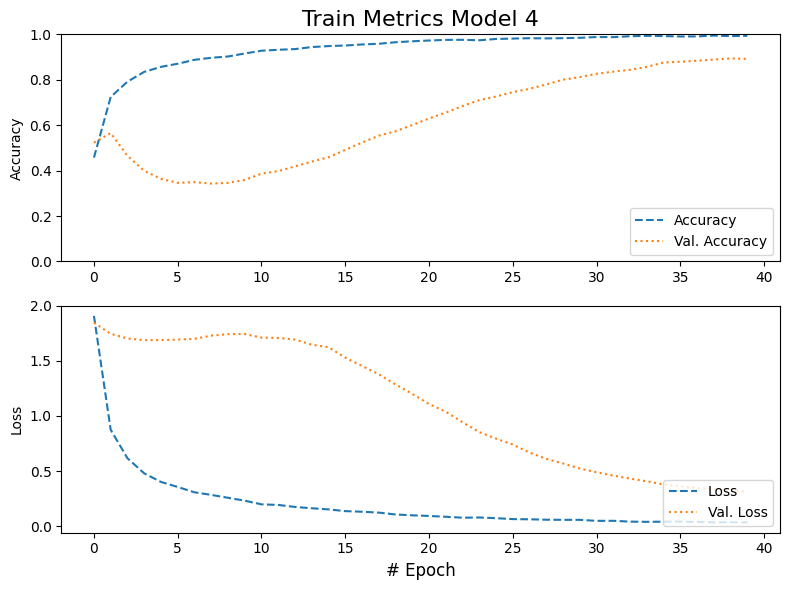

In [58]:
pd_plot(metrics_update_III, 'Train Metrics Model 4')

In [61]:
final_epoch_update_III

,Scores
accuracy,0.993735
loss,0.033741
val_accuracy,0.892110
val_loss,0.313187


In [59]:
predict_model4 =  model4.predict(x_test)
accuracy = metrics(predict_model4)[0]
print("The accuracy of Model 4 is {}".format(accuracy))
cat_ce = metrics(predict_model4)[1]
print("The categorical cross entropy of Model 4 is {}".format(cat_ce))

22/22 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step
The accuracy of Model 4 is 0.8973
The categorical cross entropy of Model 4 is 0.2759


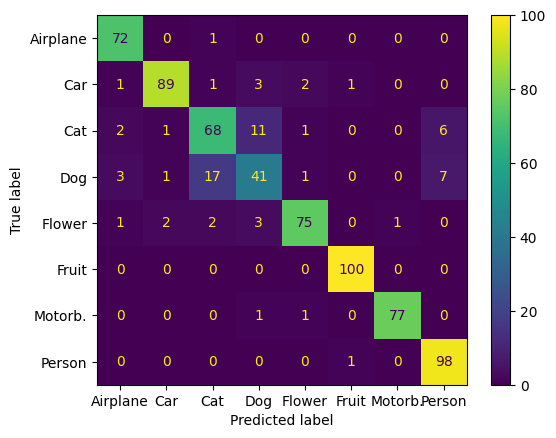

In [60]:
plot_confusion_matrix(predict_model4)

#### Model 4 evaluation
Model 4 is by far the best performing model.
- The validation accuracy and loss of Model 4 are much closer to its training counterparts than the previous three models.
- The test scores are slightly better than the validation scores.
- The confusion matrix shows six of eight categories are predicted well. The two categories with the most room for improvement are 'Cat' and 'Dog'.    

## Conclusion
- For this classification challenge, CNN benefits from a low learning rate.
- A larger amount of epochs leads to improvement in model accuracy and loss.
- There is a noticeable distinction between categories that are relatively easy to predict ('Airplane', 'Fruit', 'Motorbike', 'Person')
  and categories whose prediction is dependent on the quality of the neural network ('Car', 'Cat', 'Dog' and 'Flower').

#### Potential improvements
If I were to continue with this project, my goal would be to predict the categories 'Cat' and 'Dog' more accurately because these were the hardest categories to predict. The options I would consider:
  *  Try Model 4 with at least 50 epochs, because the increase from 20 to 40 epochs also led to an inprovement.
  *  Build a CNN with more layers, perhaps this would distinguish between the two categories.  